In [1]:
from multi_imbalance.datasets import load_datasets
import experiment_safeness_autoencoder_k20_mindist as ex
from sklearn.model_selection import StratifiedKFold
from collections import Counter, defaultdict
from multi_imbalance.utils.metrics import gmean_score
from sklearn.metrics import f1_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
import numpy as np
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from utils import plot_embeddings
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis, QuadraticDiscriminantAnalysis

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/utils/deprecation.py:143: FutureWarning: The sklearn.datasets.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.datasets. Anything that cannot be imported from sklearn.datasets is now part of the private API.
  warnings.warn(message, FutureWarning)


In [2]:
datasets = load_datasets()

In [3]:
ds_name = 'balance-scale'
test_on_all_folds = True
test_all_ds = False

In [4]:
datasets = ex.one_hot_encode_all(datasets)

In [5]:
config = ex.config_calculation_strategy2(datasets)

In [6]:
config['cmc'] = {'nn_config': {'units_1st_layer': 17,
                               'units_2nd_layer': 256,
                               'units_3rd_layer': 128,
                               'units_latent_layer': 8},
                 'weighted_triplet_loss': True,
                 'lr': 0.0002,
                 'batch_size': 16,
                 'gamma': 0.99,
                 'epochs': 30}


config['dermatology'] = {'nn_config': {'units_1st_layer': 97,
                                       'units_2nd_layer': 512,
                                       'units_3rd_layer': 256,
                                       'units_latent_layer': 16},
                         'weighted_triplet_loss': True,
                         'lr': 0.0010,
                         'batch_size': 16,
                         'gamma': 0.99,
                         'epochs': 45}

config['hayes-roth'] = {'nn_config': {'units_1st_layer': 11,
                                      'units_2nd_layer': 128,
                                      'units_3rd_layer': 64,
                                      'units_latent_layer': 16},
                        'weighted_triplet_loss': True,
                        'lr': 0.0015,
                        'batch_size': 16,
                        'gamma': 0.99,
                        'epochs': 30}

config['new_vehicle'] = {'nn_config': {'units_1st_layer': 18,
                                       'units_2nd_layer': 256,
                                       'units_3rd_layer': 128,
                                       'units_latent_layer': 16},
                         'weighted_triplet_loss': True,
                         'lr': 0.001,
                         'batch_size': 16,
                         'gamma': 0.99,
                         'epochs': 45}

config['new_yeast'] = {'nn_config': {'units_1st_layer': 9,
                                     'units_2nd_layer': 300,
                                     'units_3rd_layer': 200,
                                     'units_latent_layer': 12},
                       'weighted_triplet_loss': True,
                       'lr': 0.0004,
                       'batch_size': 32,
                       'gamma': 0.99,
                       'epochs': 3}

config['balance-scale'] = {'nn_config': {'units_1st_layer': 16,
                                         'units_2nd_layer': 256,
                                         'units_3rd_layer': 128,
                                         'units_latent_layer': 10},
                           'weighted_triplet_loss': True,
                           'lr': 0.007,
                           'batch_size': 16,
                           'gamma': 0.99,
                           'epochs': 50}

config['cleveland'] = {'nn_config': {'units_1st_layer': 24,
                                     'units_2nd_layer': 256,
                                     'units_3rd_layer': 128,
                                     'units_latent_layer': 24},
                       'weighted_triplet_loss': True,
                       'lr': 0.001,
                       'batch_size': 16,
                       'gamma': 0.99,
                       'epochs': 10}

config['cleveland_v2'] = {'nn_config': {'units_1st_layer': 23,
                                        'units_2nd_layer': 256,
                                        'units_3rd_layer': 128,
                                        'units_latent_layer': 24},
                          'weighted_triplet_loss': True,
                          'lr': 0.001,
                          'batch_size': 16,
                          'gamma': 0.99,
                          'epochs': 10}

config['glass'] = {'nn_config': {'units_1st_layer': 9,
                                 'units_2nd_layer': 256,
                                 'units_3rd_layer': 128,
                                 'units_latent_layer': 12},
                   'weighted_triplet_loss': True,
                   'lr': 0.001,
                   'batch_size': 16,
                   'gamma': 0.99,
                   'epochs': 50}

config['thyroid-newthyroid'] = {'nn_config': {'units_1st_layer': 5,
                                              'units_2nd_layer': 64,
                                              'units_3rd_layer': 32,
                                              'units_latent_layer': 8},
                                'weighted_triplet_loss': True,
                                'lr': 0.001,
                                'batch_size': 16,
                                'gamma': 0.99,
                                'epochs': 50}

config['new_ecoli'] = {'nn_config': {'units_1st_layer': 7,
                                     'units_2nd_layer': 128,
                                     'units_3rd_layer': 64,
                                     'units_latent_layer': 12},
                       'weighted_triplet_loss': True,
                       'lr': 0.0001,
                       'batch_size': 16,
                       'gamma': 0.99,
                       'epochs': 50}

config['new_led7digit'] = {'nn_config': {'units_1st_layer': 7,
                                         'units_2nd_layer': 64,
                                         'units_3rd_layer': 32,
                                         'units_latent_layer': 8},
                           'weighted_triplet_loss': True,
                           'lr': 0.001,
                           'batch_size': 16,
                           'gamma': 0.99,
                           'epochs': 50}

config['new_winequality-red'] = {'nn_config': {'units_1st_layer': 11,
                                               'units_2nd_layer': 128,
                                               'units_3rd_layer': 64,
                                               'units_latent_layer': 12},
                                 'weighted_triplet_loss': True,
                                 'lr': 0.003,
                                 'batch_size': 16,
                                 'gamma': 0.99,
                                 'epochs': 50}

config['4delikatne-bezover-cut'] = {'nn_config': {'units_1st_layer': 2,
                                                  'units_2nd_layer': 128,
                                                  'units_3rd_layer': 64,
                                                  'units_latent_layer': 8},
                                    'weighted_triplet_loss': True,
                                    'lr': 0.004,
                                    'batch_size': 16,
                                    'gamma': 0.99,
                                    'epochs': 50}

config['3mocniej-cut'] = {'nn_config': {'units_1st_layer': 2,
                                        'units_2nd_layer': 128,
                                        'units_3rd_layer': 64,
                                        'units_latent_layer': 10},
                          'weighted_triplet_loss': True,
                          'lr': 0.04,
                          'batch_size': 16,
                          'gamma': 0.99,
                          'epochs': 50}


config['1czysty-cut'] = {'nn_config': {'units_1st_layer': 2,
                                       'units_2nd_layer': 64,
                                       'units_3rd_layer': 32,
                                       'units_latent_layer': 8},
                         'weighted_triplet_loss': True,
                         'lr': 0.004,
                         'batch_size': 16,
                         'gamma': 0.99,
                         'epochs': 50}

config['2delikatne-cut'] = {'nn_config': {'units_1st_layer': 2,
                                          'units_2nd_layer': 128,
                                          'units_3rd_layer': 64,
                                          'units_latent_layer': 12},
                            'weighted_triplet_loss': True,
                            'lr': 0.04,
                            'batch_size': 16,
                            'gamma': 0.99,
                            'epochs': 10}

In [7]:
config

{'1czysty-cut': {'nn_config': {'units_1st_layer': 2,
   'units_2nd_layer': 64,
   'units_3rd_layer': 32,
   'units_latent_layer': 8},
  'weighted_triplet_loss': True,
  'lr': 0.004,
  'batch_size': 16,
  'gamma': 0.99,
  'epochs': 50},
 '2delikatne-cut': {'nn_config': {'units_1st_layer': 2,
   'units_2nd_layer': 128,
   'units_3rd_layer': 64,
   'units_latent_layer': 12},
  'weighted_triplet_loss': True,
  'lr': 0.04,
  'batch_size': 16,
  'gamma': 0.99,
  'epochs': 10},
 '3mocniej-cut': {'nn_config': {'units_1st_layer': 2,
   'units_2nd_layer': 128,
   'units_3rd_layer': 64,
   'units_latent_layer': 10},
  'weighted_triplet_loss': True,
  'lr': 0.04,
  'batch_size': 16,
  'gamma': 0.99,
  'epochs': 50},
 '4delikatne-bezover-cut': {'nn_config': {'units_1st_layer': 2,
   'units_2nd_layer': 128,
   'units_3rd_layer': 64,
   'units_latent_layer': 8},
  'weighted_triplet_loss': True,
  'lr': 0.004,
  'batch_size': 16,
  'gamma': 0.99,
  'epochs': 50},
 'balance-scale': {'nn_config': {'unit

In [8]:
autoencoder_config = ex.autoenc_config_calc_strategy1(datasets)

In [9]:
autoencoder_config['hayes-roth'] = {
    "epochs": 50,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['2delikatne-cut'] = {
    "epochs": 5,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['3mocniej-cut'] = {
    "epochs": 5,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}


autoencoder_config['cleveland'] = {
    "epochs": 50,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['cleveland_v2'] = {
    "epochs": 50,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['glass'] = {
    "epochs": 25,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}


autoencoder_config['4delikatne-bezover-cut'] = {
    "epochs": 5,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}


autoencoder_config['new_yeast'] = {
    "epochs": 30,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['new_ecoli'] = {
    "epochs": 30,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['1czysty-cut'] = {
    "epochs": 5,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

In [10]:
k_dict = ex.construct_k_dict(datasets)
k_dict['balance-scale'] = 21
k_dict['new_vehicle'] = 13
k_dict['new_yeast'] = 21
k_dict['2delikatne-cut'] = 21

In [11]:
def instantiate_classifiers():
    classifiers = {
            "RF24": RandomForestClassifier(random_state=0, min_samples_leaf=2, min_samples_split=4, class_weight='balanced'),
            "DT": DecisionTreeClassifier(random_state=0, min_samples_split=4, min_samples_leaf=2, class_weight='balanced'),
            "KNN": KNeighborsClassifier(n_neighbors=1),
            "QDA": QuadraticDiscriminantAnalysis(),
            "LDA": LinearDiscriminantAnalysis()
        } 
    return classifiers

In [12]:
from experiment import dt_name_to_cols_to_encode


In [13]:
from sklearn.neighbors import KNeighborsClassifier

def calc_safety5(X,y):
    result = {
        "safe":0,
        "borderline":0,
        "rare":0,
        "outlier":0
    }
    neigh = KNeighborsClassifier(n_neighbors=5)
    neigh.fit(X, y)
    neighbors = neigh.kneighbors(X, 5+1, False)
    for i, (x, nbors) in enumerate(list(zip(X, neighbors))):
#         print(x)
#         print(y[i])
#         print(nbors[1:])
#         print(y[nbors[1:]])
        same_class_nbrs = (y[nbors[1:]] == y[i]).sum()
        if same_class_nbrs >= 4:
            result['safe'] += 1
        elif same_class_nbrs >= 2:
            result['borderline'] += 1
        elif same_class_nbrs == 1:
            result['rare'] += 1
        else:
            result['outlier'] += 1
    return result

In [14]:
def standardize(X_train, X_test):
    means = X_train.mean(axis=0)
    stds = X_train.std(axis=0)
    return (X_train - means) / (stds+1e-6), (X_test - means) / (stds + 1e-6)

balance-scale


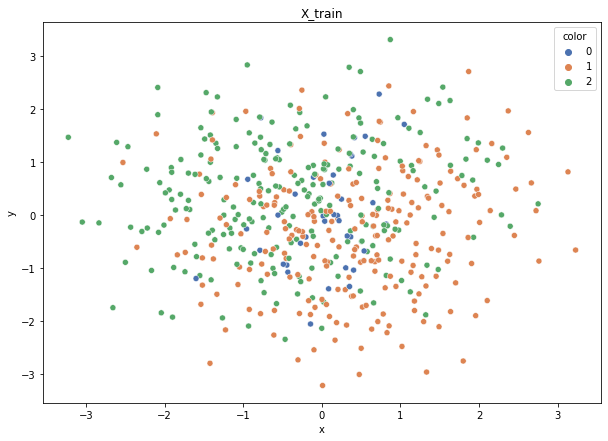

Class cardinalities: Counter({1: 231, 2: 230, 0: 39})
Weights: {0: 0.7471628063958148, 2: 0.1266928236932034, 1: 0.12614436991098174}
Training autoencoder...


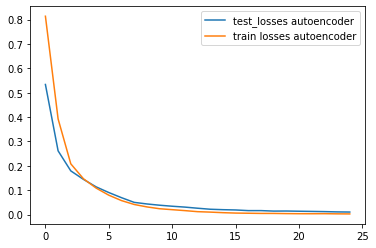

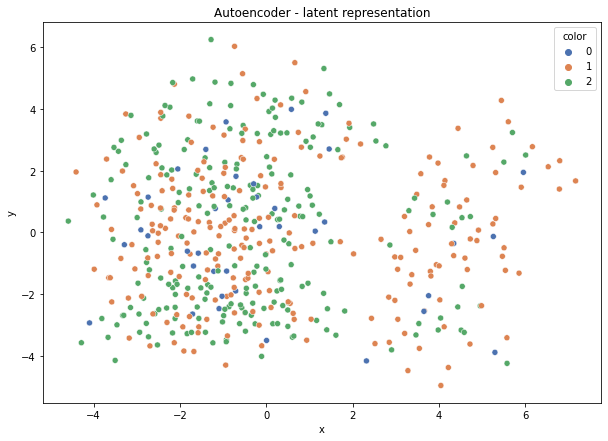

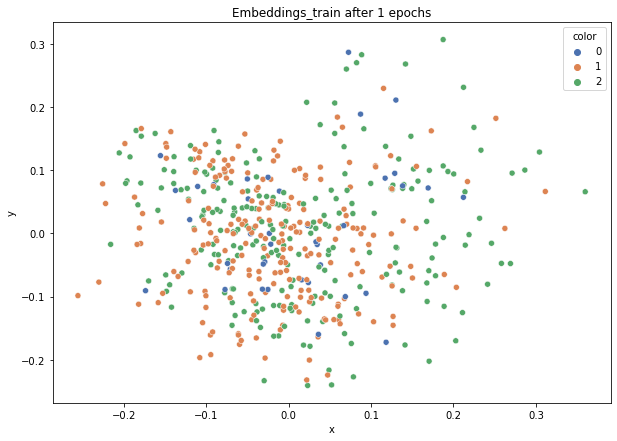

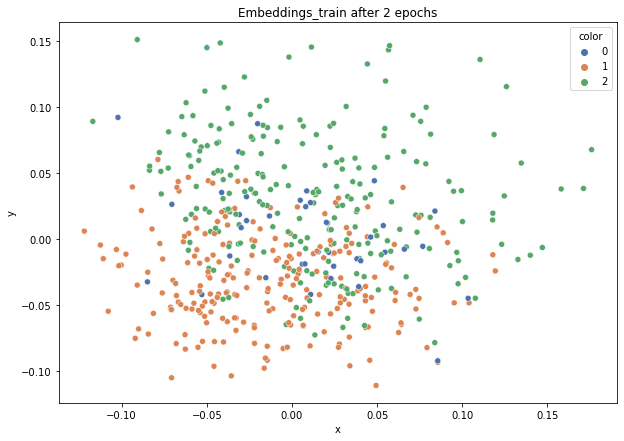

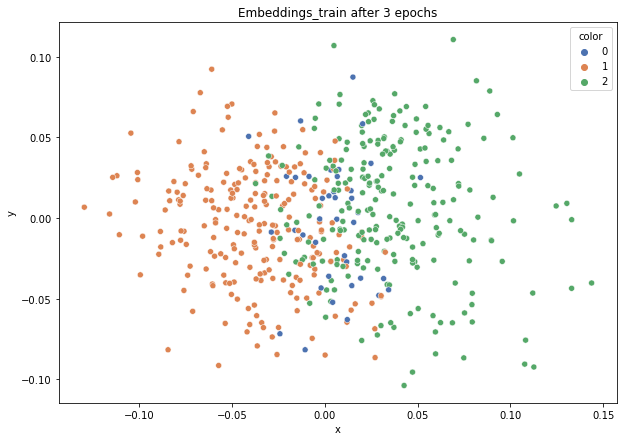

...

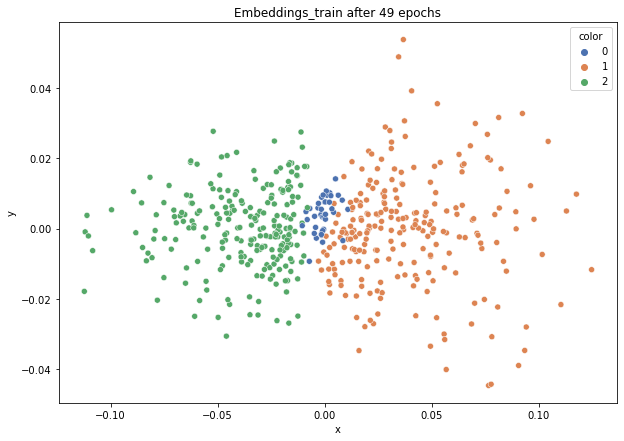

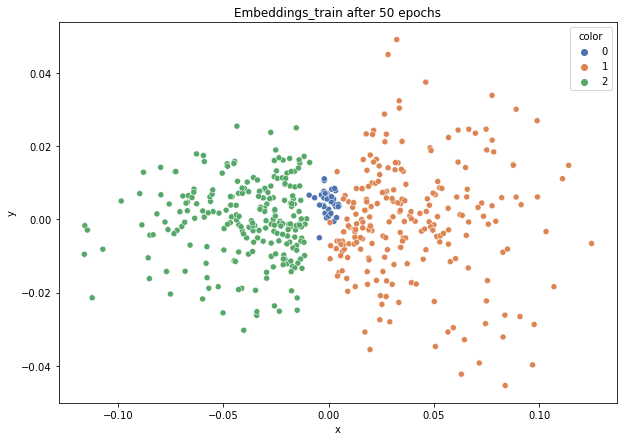

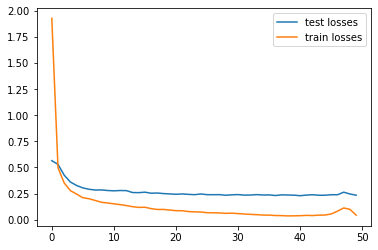

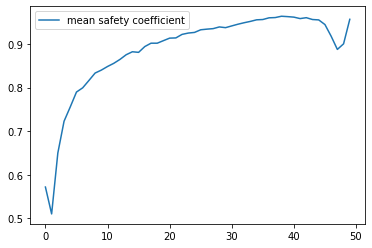

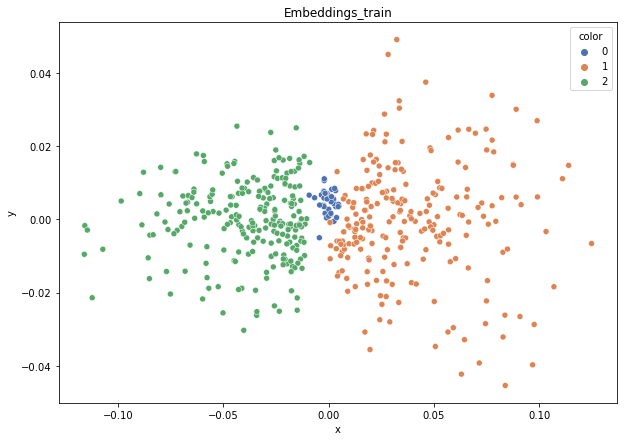

DT-f1-new-features: 0.608
DT-f1-old+new-features: 0.608
DT-f1-old-features: 0.568
DT-gmean-new-features: 0.42
DT-gmean-old+new-features: 0.42
DT-gmean-old-features: 0.088
KNN-f1-new-features: 0.63
KNN-f1-old+new-features: 0.553
KNN-f1-old-features: 0.568
KNN-gmean-new-features: 0.431
KNN-gmean-old+new-features: 0.088
KNN-gmean-old-features: 0.09
LDA-f1-new-features: 0.668
LDA-f1-old+new-features: 0.676
LDA-f1-old-features: 0.617
LDA-gmean-new-features: 0.543
LDA-gmean-old+new-features: 0.547
LDA-gmean-old-features: 0.098
QDA-f1-new-features: 0.599
QDA-f1-old+new-features: 0.569
QDA-f1-old-features: 0.936
QDA-gmean-new-features: 0.095
QDA-gmean-old+new-features: 0.092
QDA-gmean-old-features: 0.971
RF24-f1-new-features: 0.666
RF24-f1-old+new-features: 0.628
RF24-f1-old-features: 0.585
RF24-gmean-new-features: 0.543
RF24-gmean-old+new-features: 0.431
RF24-gmean-old-features: 0.092


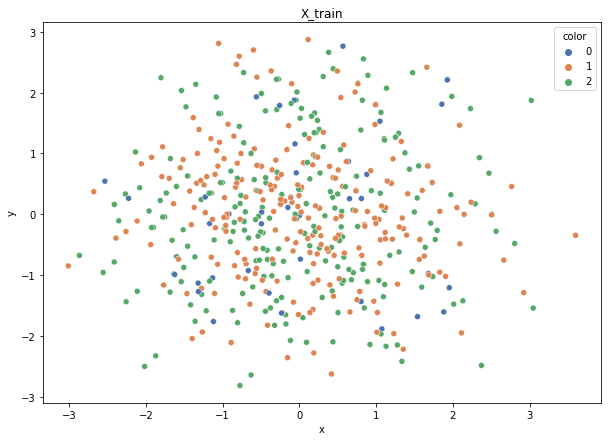

Class cardinalities: Counter({1: 231, 2: 230, 0: 39})
Weights: {0: 0.7471628063958148, 2: 0.1266928236932034, 1: 0.12614436991098174}
Training autoencoder...


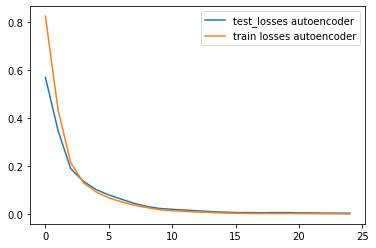

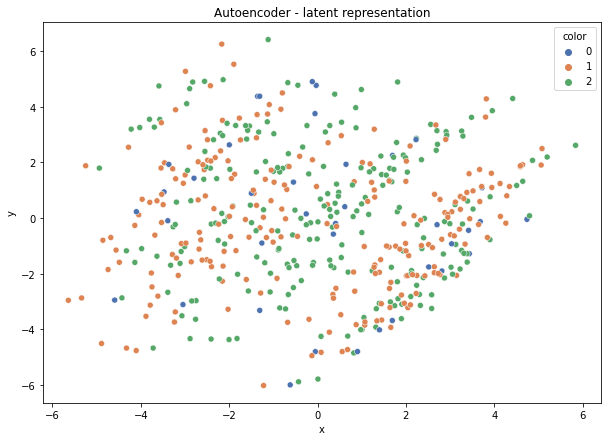

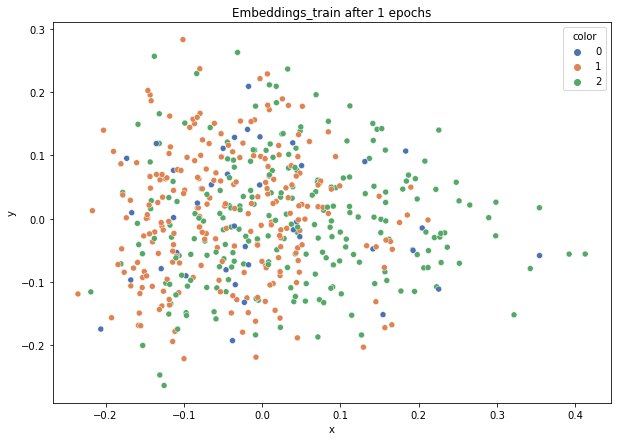

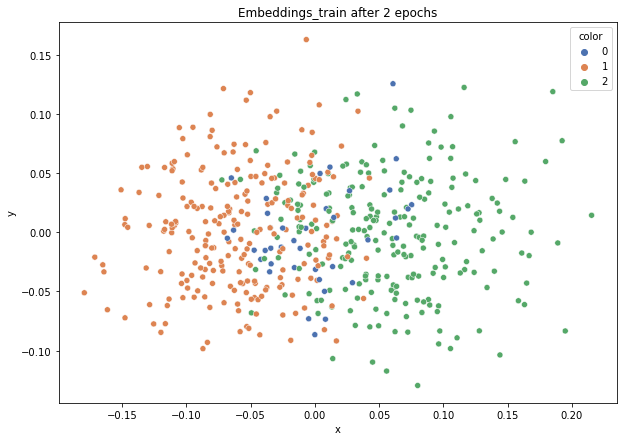

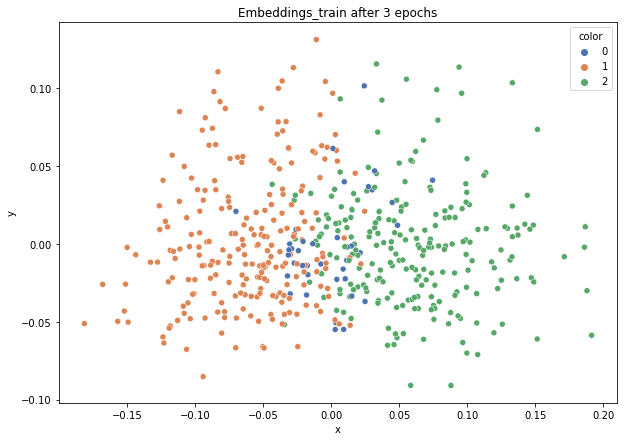

...

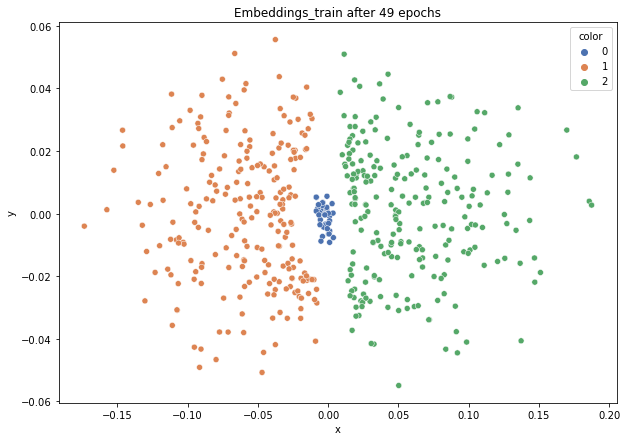

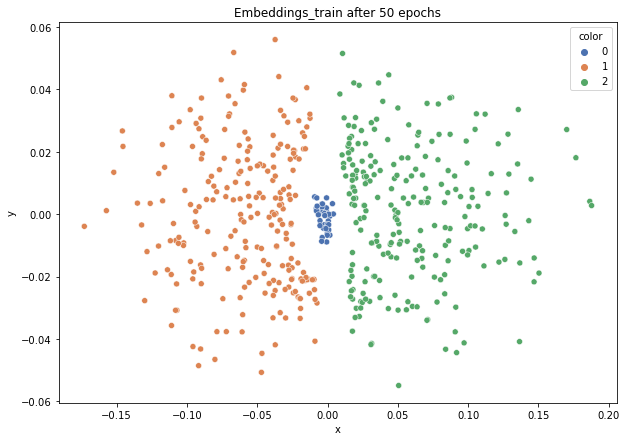

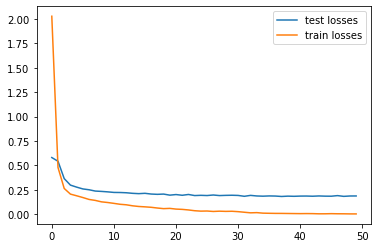

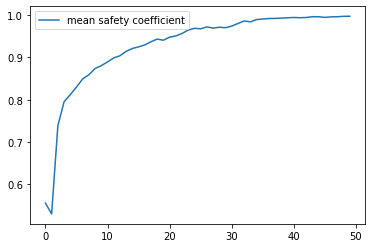

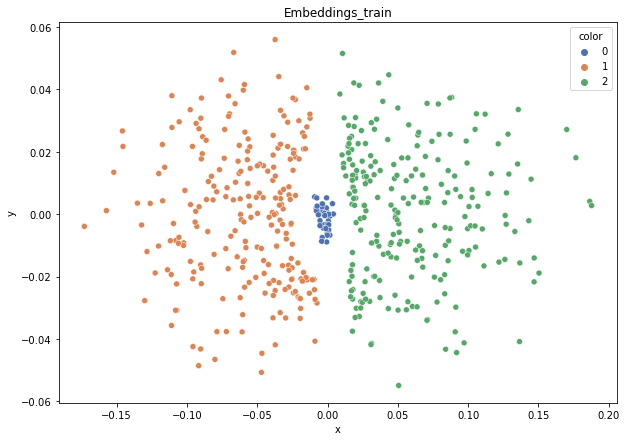

DT-f1-new-features: 0.776
DT-f1-old+new-features: 0.776
DT-f1-old-features: 0.638
DT-gmean-new-features: 0.751
DT-gmean-old+new-features: 0.751
DT-gmean-old-features: 0.585
KNN-f1-new-features: 0.795
KNN-f1-old+new-features: 0.551
KNN-f1-old-features: 0.545
KNN-gmean-new-features: 0.752
KNN-gmean-old+new-features: 0.088
KNN-gmean-old-features: 0.088
LDA-f1-new-features: 0.642
LDA-f1-old+new-features: 0.648
LDA-f1-old-features: 0.601
LDA-gmean-new-features: 0.437
LDA-gmean-old+new-features: 0.44
LDA-gmean-old-features: 0.096
QDA-f1-new-features: 0.636
QDA-f1-old+new-features: 0.595
QDA-f1-old-features: 0.845
QDA-gmean-new-features: 0.431
QDA-gmean-old+new-features: 0.095
QDA-gmean-old-features: 0.908
RF24-f1-new-features: 0.84
RF24-f1-old+new-features: 0.812
RF24-f1-old-features: 0.591
RF24-gmean-new-features: 0.814
RF24-gmean-old+new-features: 0.766
RF24-gmean-old-features: 0.092


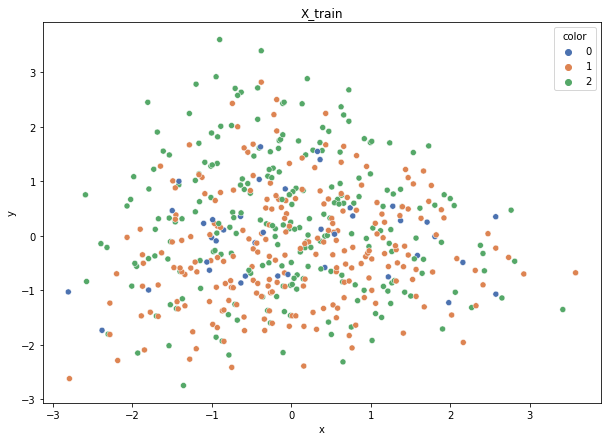

Class cardinalities: Counter({2: 231, 1: 230, 0: 39})
Weights: {2: 0.12614436991098174, 1: 0.1266928236932034, 0: 0.7471628063958148}
Training autoencoder...


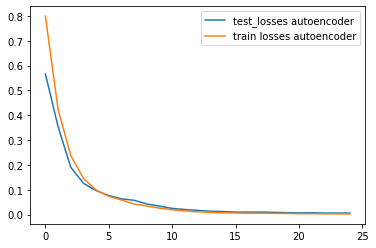

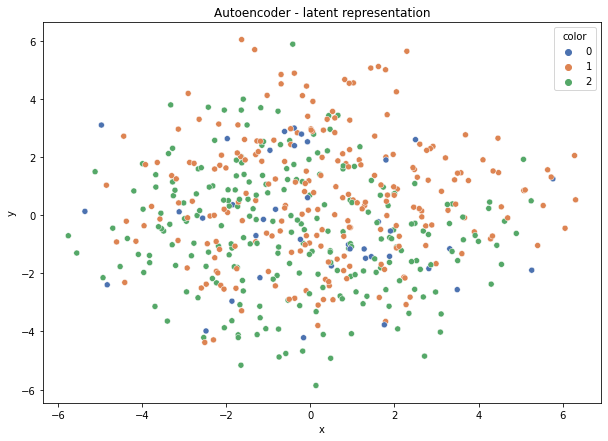

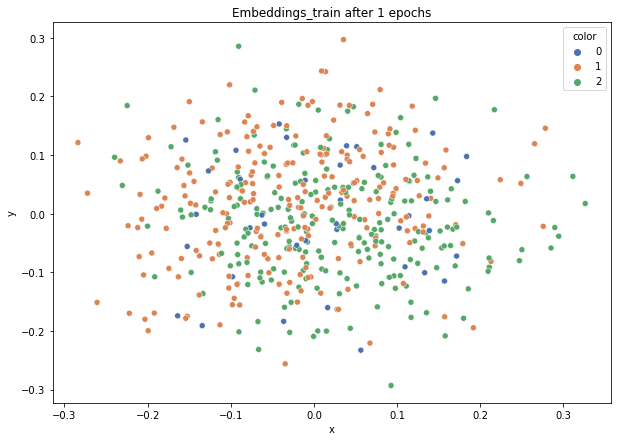

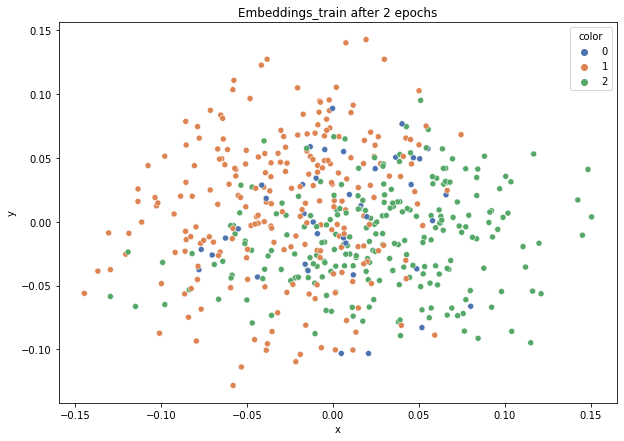

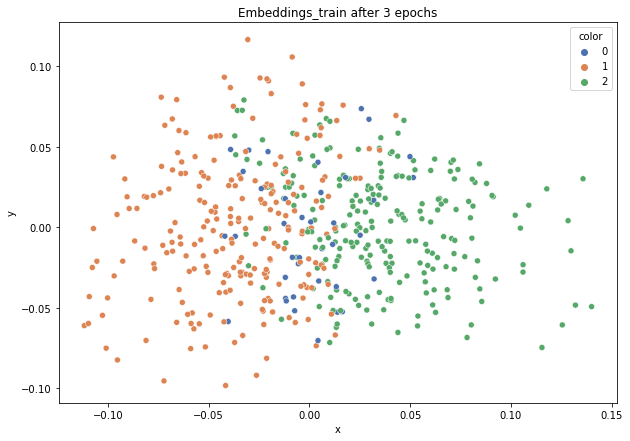

...

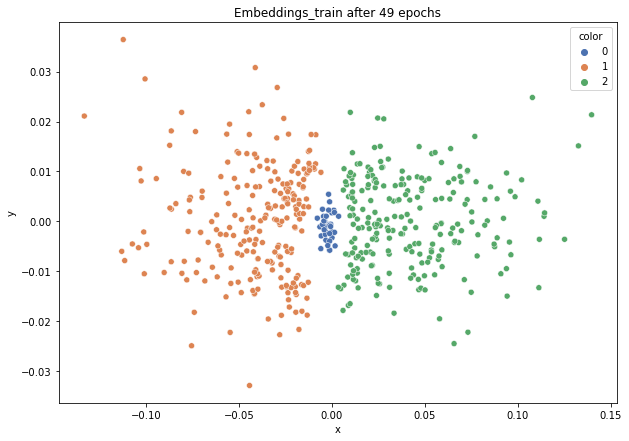

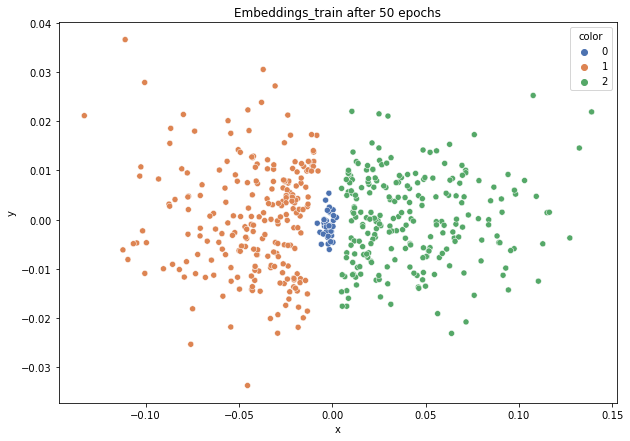

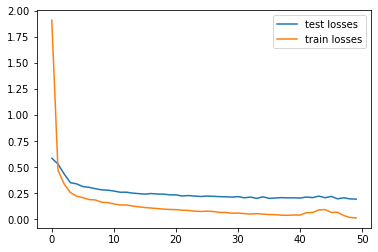

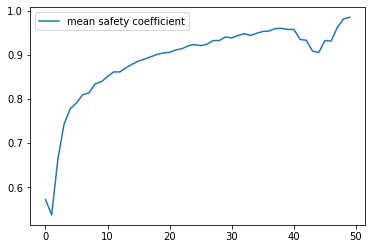

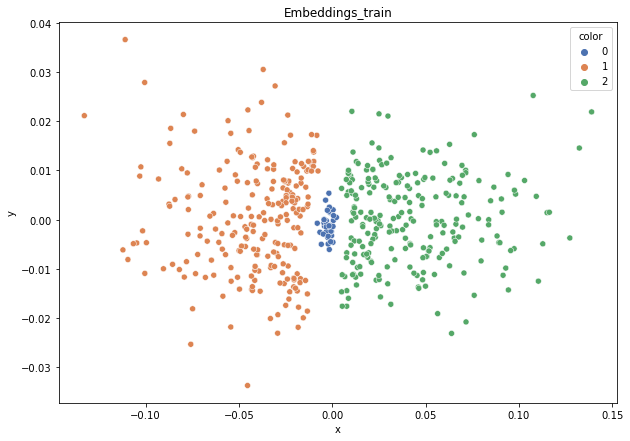

DT-f1-new-features: 0.72
DT-f1-old+new-features: 0.709
DT-f1-old-features: 0.655
DT-gmean-new-features: 0.634
DT-gmean-old+new-features: 0.625
DT-gmean-old-features: 0.597
KNN-f1-new-features: 0.657
KNN-f1-old+new-features: 0.593
KNN-f1-old-features: 0.566
KNN-gmean-new-features: 0.54
KNN-gmean-old+new-features: 0.093
KNN-gmean-old-features: 0.09
LDA-f1-new-features: 0.587
LDA-f1-old+new-features: 0.601
LDA-f1-old-features: 0.6
LDA-gmean-new-features: 0.093
LDA-gmean-old+new-features: 0.095
LDA-gmean-old-features: 0.096
QDA-f1-new-features: 0.577
QDA-f1-old+new-features: 0.595
QDA-f1-old-features: 0.836
QDA-gmean-new-features: 0.093
QDA-gmean-old+new-features: 0.095
QDA-gmean-old-features: 0.923
RF24-f1-new-features: 0.634
RF24-f1-old+new-features: 0.634
RF24-f1-old-features: 0.602
RF24-gmean-new-features: 0.434
RF24-gmean-old+new-features: 0.434
RF24-gmean-old-features: 0.093


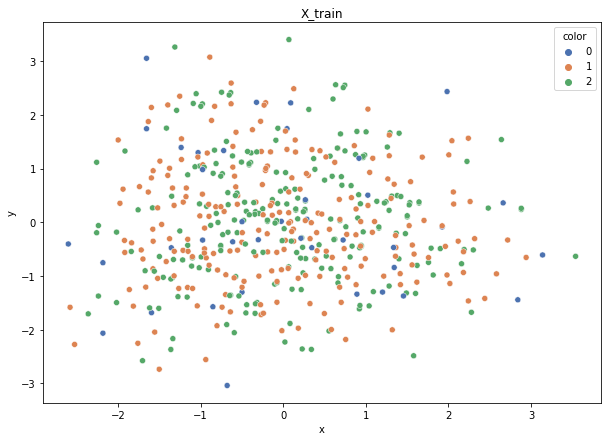

Class cardinalities: Counter({2: 231, 1: 230, 0: 39})
Weights: {0: 0.7471628063958148, 2: 0.12614436991098174, 1: 0.1266928236932034}
Training autoencoder...


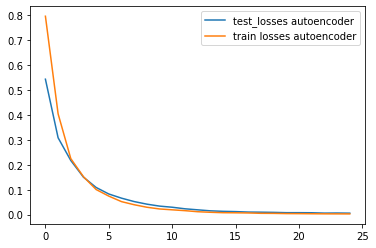

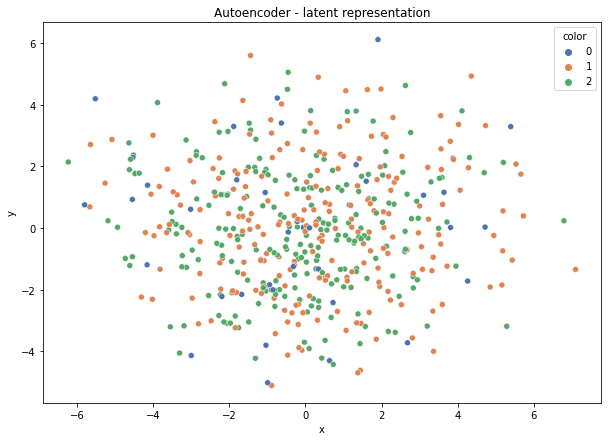

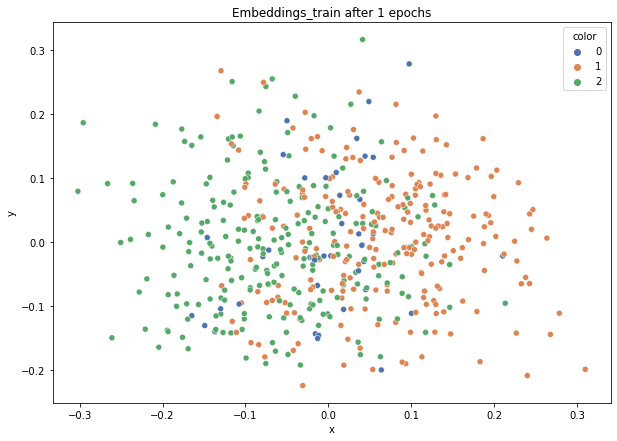

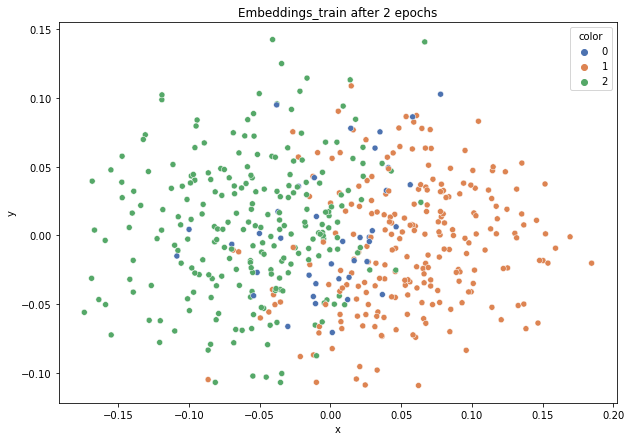

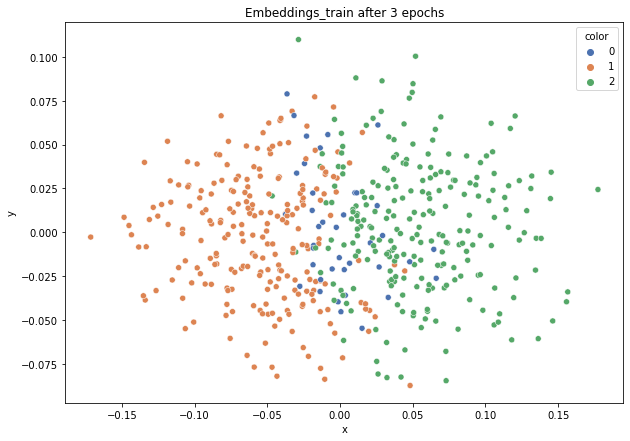

...

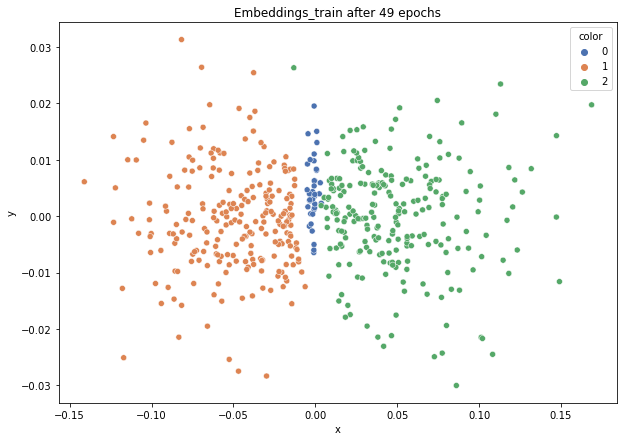

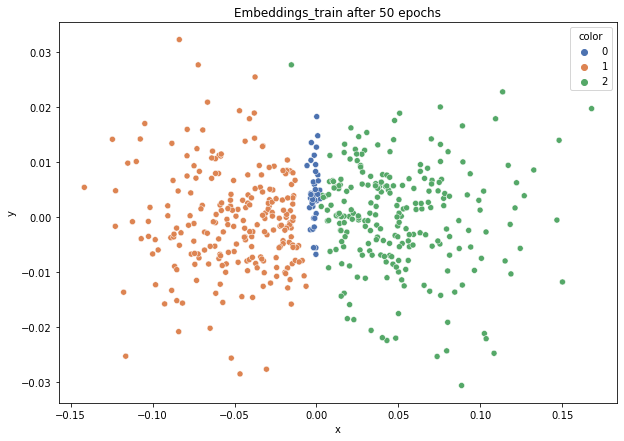

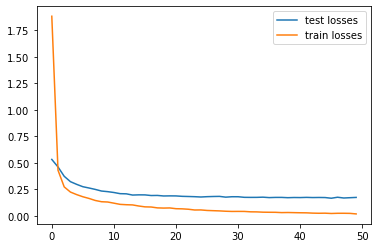

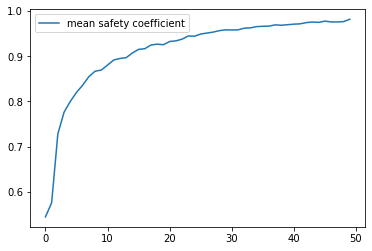

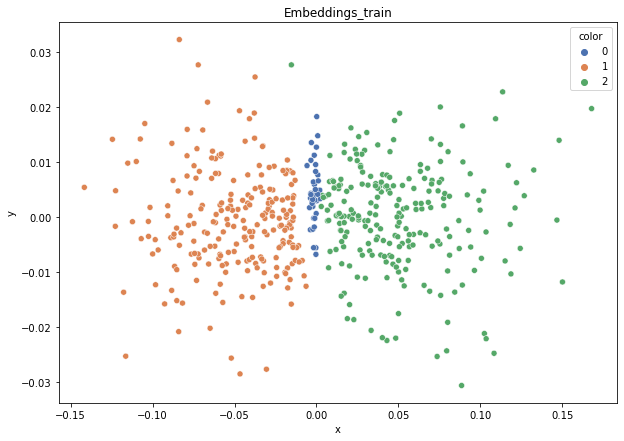

DT-f1-new-features: 0.757
DT-f1-old+new-features: 0.723
DT-f1-old-features: 0.582
DT-gmean-new-features: 0.698
DT-gmean-old+new-features: 0.63
DT-gmean-old-features: 0.397
KNN-f1-new-features: 0.844
KNN-f1-old+new-features: 0.551
KNN-f1-old-features: 0.562
KNN-gmean-new-features: 0.852
KNN-gmean-old+new-features: 0.087
KNN-gmean-old-features: 0.089
LDA-f1-new-features: 0.605
LDA-f1-old+new-features: 0.608
LDA-f1-old-features: 0.6
LDA-gmean-new-features: 0.095
LDA-gmean-old+new-features: 0.096
LDA-gmean-old-features: 0.096
QDA-f1-new-features: 0.711
QDA-f1-old+new-features: 0.7
QDA-f1-old-features: 0.809
QDA-gmean-new-features: 0.557
QDA-gmean-old+new-features: 0.55
QDA-gmean-old-features: 0.862
RF24-f1-new-features: 0.793
RF24-f1-old+new-features: 0.826
RF24-f1-old-features: 0.603
RF24-gmean-new-features: 0.715
RF24-gmean-old+new-features: 0.771
RF24-gmean-old-features: 0.094


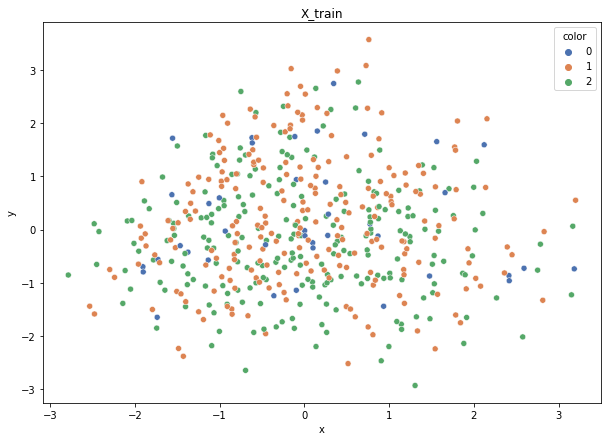

Class cardinalities: Counter({2: 230, 1: 230, 0: 40})
Weights: {0: 0.7419354838709677, 2: 0.12903225806451613, 1: 0.12903225806451613}
Training autoencoder...


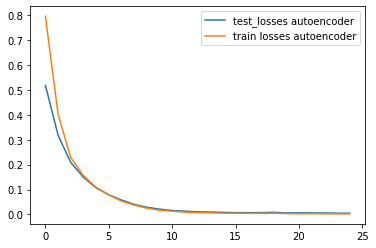

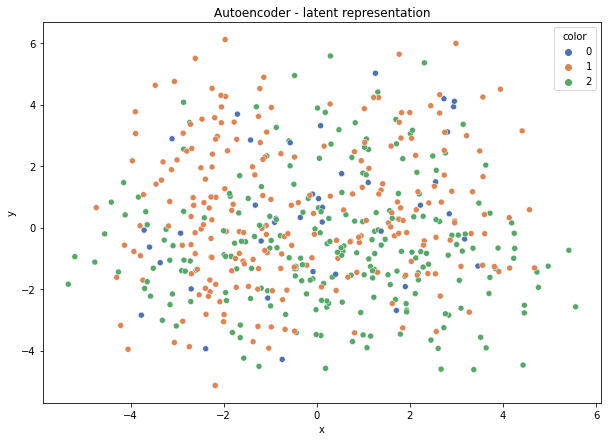

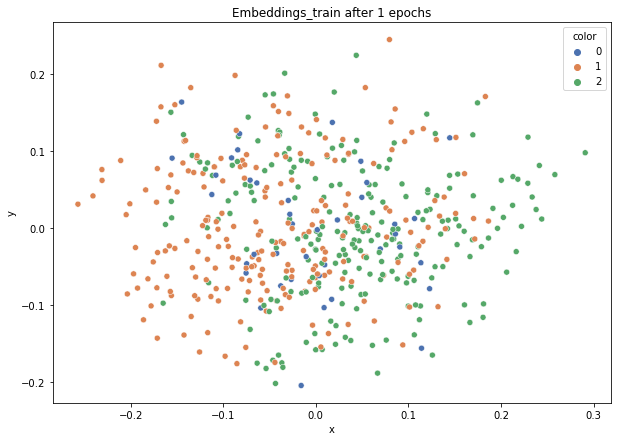

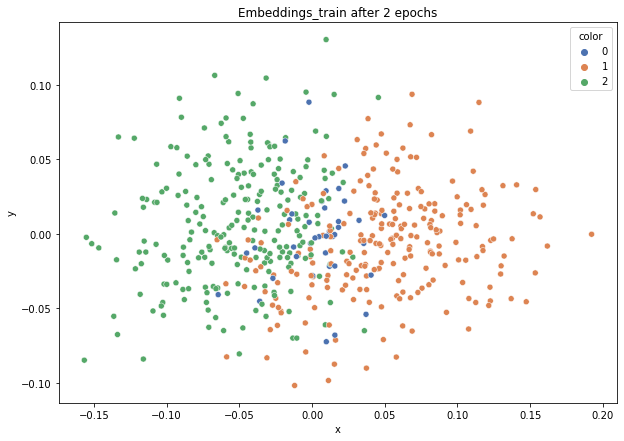

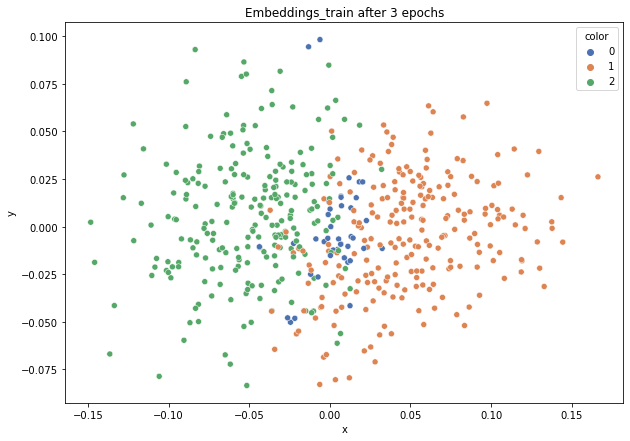

...

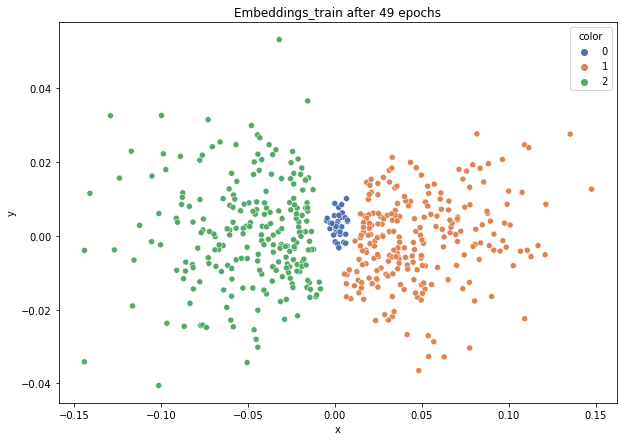

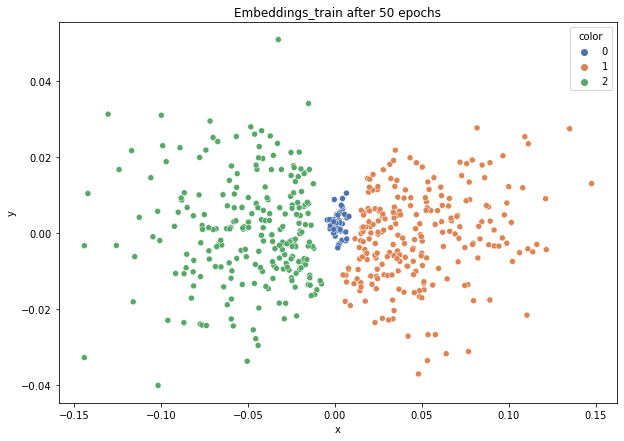

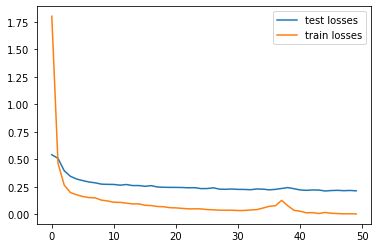

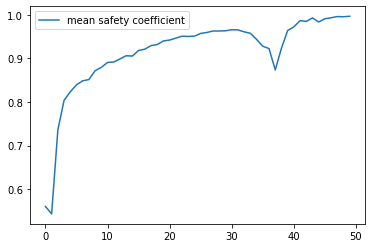

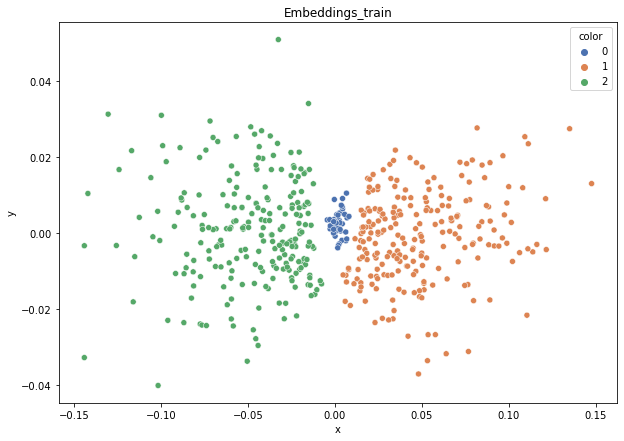

DT-f1-new-features: 0.711
DT-f1-old+new-features: 0.711
DT-f1-old-features: 0.582
DT-gmean-new-features: 0.74
DT-gmean-old+new-features: 0.74
DT-gmean-old-features: 0.415
KNN-f1-new-features: 0.656
KNN-f1-old+new-features: 0.564
KNN-f1-old-features: 0.563
KNN-gmean-new-features: 0.615
KNN-gmean-old+new-features: 0.09
KNN-gmean-old-features: 0.089
LDA-f1-new-features: 0.575
LDA-f1-old+new-features: 0.584
LDA-f1-old-features: 0.62
LDA-gmean-new-features: 0.091
LDA-gmean-old+new-features: 0.092
LDA-gmean-old-features: 0.098
QDA-f1-new-features: 0.559
QDA-f1-old+new-features: 0.564
QDA-f1-old-features: 0.859
QDA-gmean-new-features: 0.091
QDA-gmean-old+new-features: 0.092
QDA-gmean-old-features: 0.917
RF24-f1-new-features: 0.7
RF24-f1-old+new-features: 0.69
RF24-f1-old-features: 0.587
RF24-gmean-new-features: 0.574
RF24-gmean-old+new-features: 0.57
RF24-gmean-old-features: 0.091


In [15]:
result_dict = defaultdict(list)

safety_dict = defaultdict(list)

if test_all_ds:
    ds_names = dt_name_to_cols_to_encode.keys()
else:
    ds_names = [ds_name]
for dataset_name in ds_names:
# for dataset_name in list(datasets.keys()):
    print(dataset_name)
    result_dict["dataset"].append(dataset_name)
    fold_result_dict = defaultdict(list)

    safety_dict["dataset"].append(dataset_name)
    fold_safety_dict = defaultdict(list)

    X, y = datasets[dataset_name]['data'], datasets[dataset_name]['target']
    X_encoded, y = datasets[f"{dataset_name}_encoded"]['data'], datasets[f"{dataset_name}_encoded"]['target']

    skf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
    n_splits = skf.get_n_splits(X, y)

    folds = []
    if test_on_all_folds:
        folds = skf.split(X, y)
    else:
        folds = list(skf.split(X, y))[1:2]

    for train_index, test_index in folds:
        try:
            X_train, X_test = X[train_index], X[test_index]
            X_train_norm, X_test_norm = standardize(X_train, X_test)
            y_train, y_test = y[train_index], y[test_index]


            X_train_enc, X_test_enc = X_encoded[train_index], X_encoded[test_index]
            X_train_enc, X_test_enc = standardize(X_train_enc, X_test_enc)


            # PCA X_train
            pca = PCA(n_components=2)
            pca.fit(X_train_enc)
            plot_embeddings(pca.transform(X_train_enc), y_train)
            plt.title("X_train")
            plt.show()

            weights = ex.weights_calculation_strategy1(X_train, y_train)
            cfg =  config[dataset_name]
            # pretrain ANN triplets
            autoenc_cfg = autoencoder_config[dataset_name]
            embeddings_train, embeddings_test = ex.train_triplets(X_train_enc, y_train, X_test_enc, y_test, weights,cfg, pca, autoenc_cfg, k_dict[dataset_name])

            s_dict = calc_safety5(embeddings_test, y_test)
            for k, v in s_dict.items():
                fold_safety_dict[f"emb-{k}"].append(v)

            s_dict = calc_safety5(X_test_enc, y_test)
            for k,v in s_dict.items():
                fold_safety_dict[f"raw-{k}"].append(v)

            # PCA embeddings_train
            pca = PCA(n_components=2)
            plot_embeddings(pca.fit_transform(embeddings_train), y_train)
            plt.title("Embeddings_train")
            plt.show()

            X_train_new = np.hstack([X_train_norm, embeddings_train])
            X_test_new = np.hstack([X_test_norm, embeddings_test])

            classifiers = instantiate_classifiers()
            for clf_name, clf in classifiers.items():
                clf.fit(X_train_norm, y_train)
                preds = clf.predict(X_test_norm)

                gmean = gmean_score(y_test, preds)
                f1 = f1_score(y_test, preds, average='macro')
                fold_result_dict[f"{clf_name}-f1-old-features"].append(f1)
                fold_result_dict[f"{clf_name}-gmean-old-features"].append(gmean)

            classifiers = instantiate_classifiers()
            for clf_name, clf in classifiers.items():
                clf.fit(X_train_new, y_train)
                preds = clf.predict(X_test_new)

                gmean = gmean_score(y_test, preds)
                f1 = f1_score(y_test, preds, average='macro')
                fold_result_dict[f"{clf_name}-f1-old+new-features"].append(f1)
                fold_result_dict[f"{clf_name}-gmean-old+new-features"].append(gmean)

            classifiers = instantiate_classifiers()
            for clf_name, clf in classifiers.items():
                clf.fit(embeddings_train, y_train)
                preds = clf.predict(embeddings_test)

                gmean = gmean_score(y_test, preds)
                f1 = f1_score(y_test, preds, average='macro')
                fold_result_dict[f"{clf_name}-f1-new-features"].append(f1)
                fold_result_dict[f"{clf_name}-gmean-new-features"].append(gmean)
            for key in sorted(list(fold_result_dict.keys())):
                print(f"{key}: {np.round(fold_result_dict[key][-1],3)}")
        except:
            print("Error in one of the folds")

    for k in fold_result_dict:
        result_dict[k].append(np.mean(fold_result_dict[k]))

    for k in fold_safety_dict:
        safety_dict[k].append(np.sum(fold_safety_dict[k]) / X.shape[0])

In [16]:
results_df = pd.DataFrame.from_dict(result_dict)

In [17]:
# safety_dict['emb-outlier'].append("None")

In [18]:
safety_df = pd.DataFrame.from_dict(safety_dict)

In [19]:
results_df

,dataset,RF24-f1-old-features,RF24-gmean-old-features,DT-f1-old-features,DT-gmean-old-features,KNN-f1-old-features,KNN-gmean-old-features,QDA-f1-old-features,QDA-gmean-old-features,LDA-f1-old-features,...,RF24-f1-new-features,RF24-gmean-new-features,DT-f1-new-features,DT-gmean-new-features,KNN-f1-new-features,KNN-gmean-new-features,QDA-f1-new-features,QDA-gmean-new-features,LDA-f1-new-features,LDA-gmean-new-features
0,balance-scale,0.593905,0.092184,0.605016,0.416495,0.560676,0.089082,0.857046,0.916265,0.607652,...,0.7266,0.615988,0.714434,0.648448,0.716162,0.637922,0.616247,0.253524,0.615446,0.251871


In [20]:
safety_df[sorted(safety_df.filter(regex=("dataset|emb")).columns)].style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,emb-borderline,emb-outlier,emb-rare,emb-safe
0,balance-scale,0.131200,0.030400,0.075200,0.763200


In [21]:
safety_df[sorted(safety_df.filter(regex=("dataset|raw")).columns)].style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,raw-borderline,raw-outlier,raw-rare,raw-safe
0,balance-scale,0.505600,0.064000,0.120000,0.310400


In [22]:
safety_df[sorted(safety_df.filter(regex=("dataset|.*safe")).columns)].style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,emb-safe,raw-safe
0,balance-scale,0.763200,0.310400


In [23]:
results_df.filter(regex=("dataset|RF24-f1*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,RF24-f1-old-features,RF24-f1-old+new-features,RF24-f1-new-features
0,balance-scale,0.593905,0.718025,0.726600


In [24]:
results_df.filter(regex=("dataset|RF24-gmean*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,RF24-gmean-old-features,RF24-gmean-old+new-features,RF24-gmean-new-features
0,balance-scale,0.092184,0.594335,0.615988


In [25]:
results_df.filter(regex=("dataset|DT-f1*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,DT-f1-old-features,DT-f1-old+new-features,DT-f1-new-features
0,balance-scale,0.605016,0.705282,0.714434


In [26]:
results_df.filter(regex=("dataset|DT-gmean*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,DT-gmean-old-features,DT-gmean-old+new-features,DT-gmean-new-features
0,balance-scale,0.416495,0.633190,0.648448


In [27]:
results_df.filter(regex=("dataset|KNN-f1*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,KNN-f1-old-features,KNN-f1-old+new-features,KNN-f1-new-features
0,balance-scale,0.560676,0.562516,0.716162


In [28]:
results_df.filter(regex=("dataset|KNN-gmean*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,KNN-gmean-old-features,KNN-gmean-old+new-features,KNN-gmean-new-features
0,balance-scale,0.089082,0.089148,0.637922


In [29]:
results_df.filter(regex=("dataset|QDA-f1*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,QDA-f1-old-features,QDA-f1-old+new-features,QDA-f1-new-features
0,balance-scale,0.857046,0.604492,0.616247


In [30]:
results_df.filter(regex=("dataset|QDA-gmean*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,QDA-gmean-old-features,QDA-gmean-old+new-features,QDA-gmean-new-features
0,balance-scale,0.916265,0.184995,0.253524


In [31]:
results_df.filter(regex=("dataset|LDA-f1*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,LDA-f1-old-features,LDA-f1-old+new-features,LDA-f1-new-features
0,balance-scale,0.607652,0.623431,0.615446


In [32]:
results_df.filter(regex=("dataset|LDA-gmean*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,LDA-gmean-old-features,LDA-gmean-old+new-features,LDA-gmean-new-features
0,balance-scale,0.096584,0.253715,0.251871
